# MRI - Style Transfer using Cycle GAN
by   
- `Vijay Prasad`

## Problem Statement

Misdiagnosis in the medical field is a very serious issue but it’s also uncomfortably common to occur. Imaging procedures in the medical field requires an expert radiologist’s opinion since interpreting them is not a simple binary process ( Normal or Abnormal). Even so, one radiologist may see something that another does not. This can lead to conflicting reports and make it difficult to effectively recommend treatment options to the patient.

One of the complicated tasks in medical imaging is to diagnose MRI(Magnetic Resonance Imaging). Sometimes to interpret the scan, the radiologist needs different variations of the imaging which can drastically enhance the accuracy of diagnosis by providing practitioners with a more comprehensive understanding.
 
But to have access to different imaging is difficult and expensive. With the help of deep learning, we can use style transfer to generate artificial MRI images of different contrast levels from existing MRI scans. This will help to provide a better diagnosis with the help of an additional image.

To achieve this, a Generative adversarial model(modified U-Net) need to be built which can generate artificial MRI images of different contrast levels from existing MRI scans. Thi also involves the use of CycleGAN to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs
create T2 weighted images from T1 weighted MRI image and vice-versa.

## Process Involved

- Data Loading and Understanding
- Image Preprocessing
- Model Building and Training


#### Importing the Required Libraries

In [1]:
#Import all the required libraries

import os
from os import listdir
import numpy as np
from numpy import asarray
import glob
import imageio
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow as tf
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from keras.utils.vis_utils import plot_model
import warnings
warnings.filterwarnings('ignore')

## Data Loading and Understanding

#### Dataset Used:
-`Unpaired MRI T1 and T2 Image dataset` 

Load the images & create two seperate datasets. The input shape for image should be (128, 128)

In [2]:
# load and resize images
def load_images(path, size=(128,128)):
    data_list = list()
    
    for filename in listdir(path):     
        pixels = load_img(path + filename, target_size=size)
        # convert to numpy array
        pixels = img_to_array(pixels)
        # store the data
        data_list.append(pixels)
    return asarray(data_list)

In [3]:
# load dataset tr1
import tensorflow as tf
tr1_data = load_images('MRI+T1_T2+Dataset/Tr1/TrainT1/') #write your code to create the dataset from image directory
tr1_data = tf.image.rgb_to_grayscale(tr1_data) #convert to grayscale
tr1= tf.data.Dataset.from_tensor_slices(tf.convert_to_tensor(tr1_data))
tr1 

Metal device set to: Apple M2


2023-03-29 01:43:52.463287: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-03-29 01:43:52.463362: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


<TensorSliceDataset element_spec=TensorSpec(shape=(128, 128, 1), dtype=tf.float32, name=None)>

In [4]:
# load dataset tr2
tr2_data = load_images('MRI+T1_T2+Dataset/Tr2/TrainT2/') #write your code to create the dataset from image directory
tr2_data = tf.image.rgb_to_grayscale(tr2_data) #convert to grayscale
tr2= tf.data.Dataset.from_tensor_slices(tf.convert_to_tensor(tr2_data))
tr2

<TensorSliceDataset element_spec=TensorSpec(shape=(128, 128, 1), dtype=tf.float32, name=None)>

## Image Preprocessing

- Create a python function to process images with normalisation
- Apply the function to both datasets
- Visualise the MRI images after processing

In [5]:
# Setting input image Buffer & Batch Size
BUFFER_SIZE = 1000
BATCH_SIZE = 15

In [6]:
# normalizing the images to [-1, 1]
def normalize(image):
    image =  tf.cast(image, tf.float32)
    image= (image / 127.5) - 1 
    return image

In [7]:
def preprocess_image_train(image):
    image = tf.image.random_flip_left_right(image)
    image = normalize(image)   
    return image

In [8]:
# process both classes of MRI images
import tensorflow as tf
AUTOTUNE = tf.data.experimental.AUTOTUNE
tr1 = tr1 .map(preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
tr2 = tr2 .map(preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [9]:
sample_tr1 = next(iter(tr1)) # Sample T1 Image
sample_tr2 = next(iter(tr2)) # Sample T2 Image

2023-03-29 01:43:52.636377: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


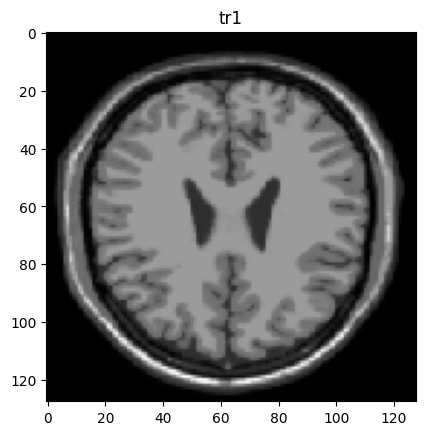

In [10]:
# Plot T1 Sample Image
plt.title('tr1')
plt.imshow(sample_tr1[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

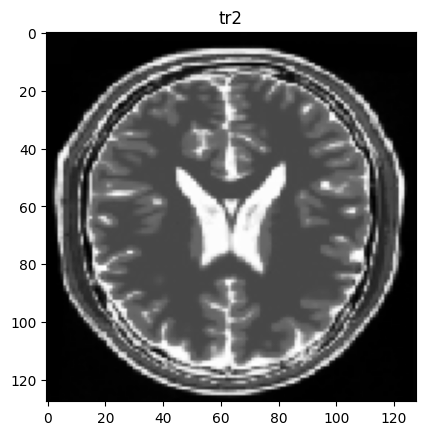

In [11]:
# Plot T2 Sample Image
plt.title('tr2')
plt.imshow(sample_tr2[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

T1 data examples


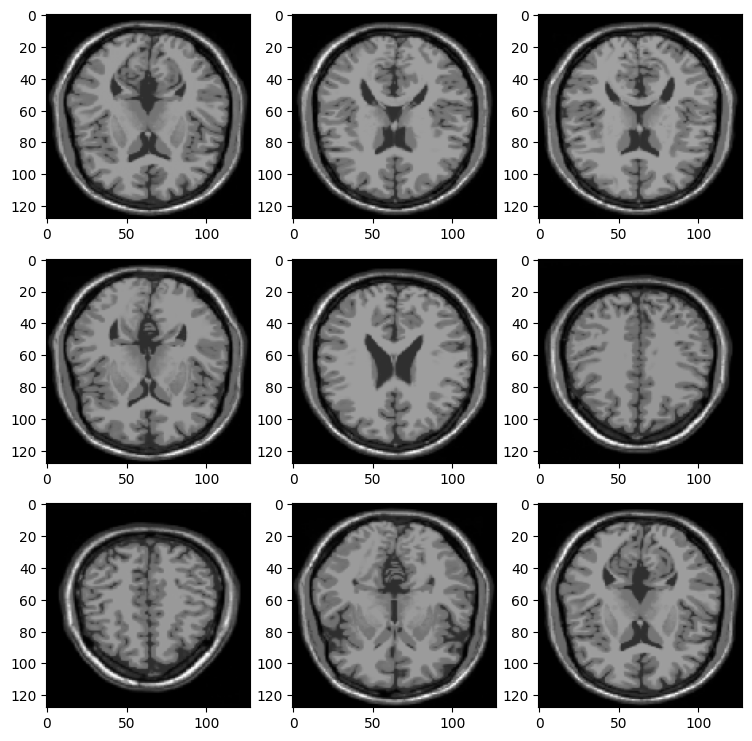

In [12]:
# Visualizing data from T1 dataset
plt.figure(figsize=(9, 9))
for images in tr1.take(1):
  print("T1 data examples")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i], cmap='gray')

T2 data examples


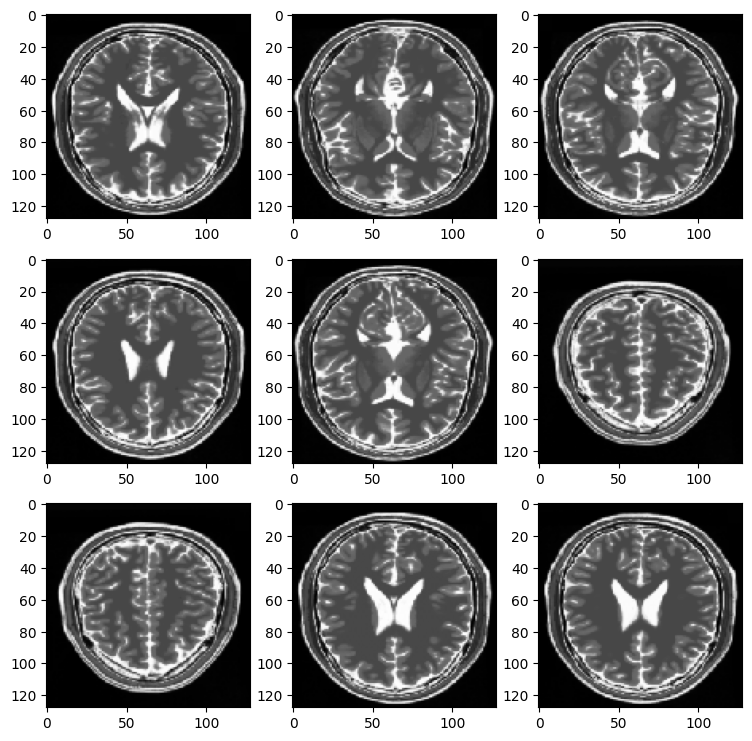

In [13]:
# Visualizing data from T2 dataset
plt.figure(figsize=(9, 9))
for images in tr2.take(1):
  print("T2 data examples")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i], cmap='gray')

## Model Building and Training

#### Model Building 
- Instance Normalization 
- Downsampling, Upsampling and Unet 
- Generator Building using Unet 
- Discriminator Building 

#### Instance Normalization

In [14]:
class InstanceNormalization(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5):
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
        
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
        
    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset



#### Downsampling


In [15]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result


#### Upsampling


In [16]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result


#### Unet Generator

- Unet Generator is a combination of Convolution + Transposed Convolution Layers


In [17]:
def unet_generator():
   
    down_stack = [
        downsample(64, 4, True), # (bs, 64, 64, 64)
        downsample(64, 4),        # (bs, 32, 32, 64)
        downsample(128, 4),       # (bs, 16, 16, 128)
        downsample(128, 4),       # (bs, 8, 8, 128)
        downsample(256, 4),       # (bs, 4, 4, 256)
        downsample(256, 4),       # (bs, 2, 2, 256)
        downsample(512, 4)]       # Bottleneck layer (bs, 1, 1, 512)
    
    up_stack = [
        upsample(256, 4, True),   # (bs, 2, 2, 256)
        upsample(256, 4),         # (bs, 4, 4, 256)
        upsample(128, 4),         # (bs, 8, 8, 128)
        upsample(128, 4),         # (bs, 16, 16,128)
        upsample(64, 4),          # (bs, 32, 32, 64)
        upsample(64, 4)]           # (bs, 64, 64, 64)
     #create a stack of upsample models
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') 
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [18]:
generator_g = unet_generator() #initialise the generator
generator_f = unet_generator() #initialise the generator

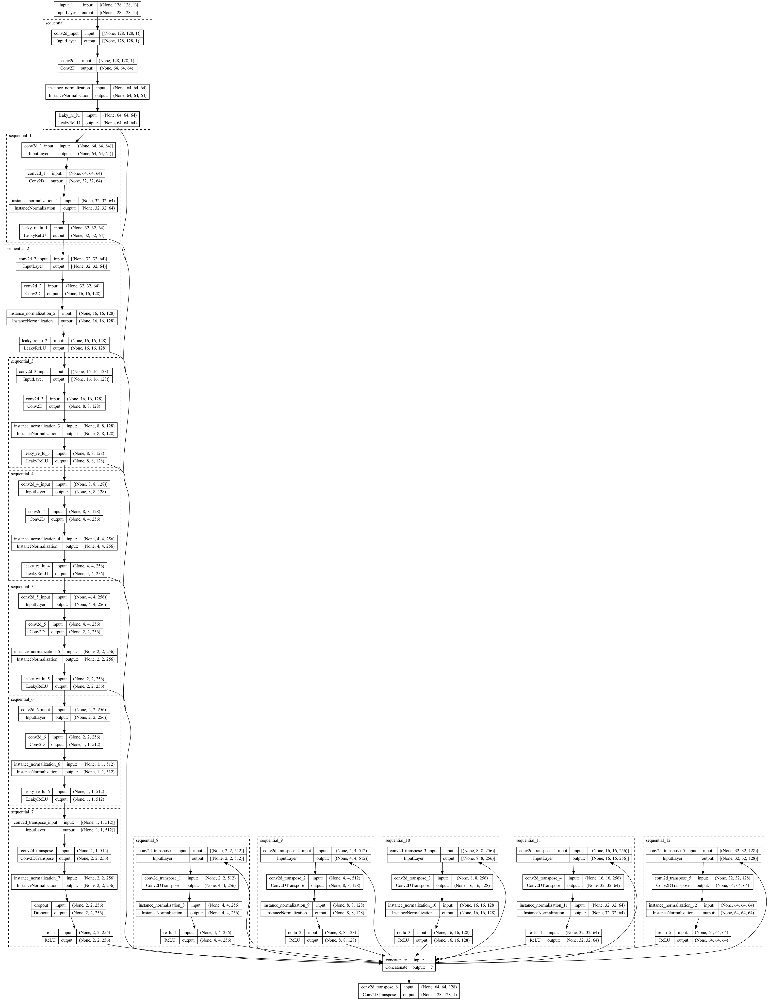

In [19]:
# Visualize model architecture of generator
plot_model(generator_g, show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True, dpi=96)

In [20]:
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 64, 64, 64)   1152        ['input_1[0][0]']                
                                                                                                  
 sequential_1 (Sequential)      (None, 32, 32, 64)   65664       ['sequential[0][0]']             
                                                                                                  
 sequential_2 (Sequential)      (None, 16, 16, 128)  131328      ['sequential_1[0][0]']       

#### Discriminator

- Discriminators only contain Convolutional layers and no Transposed Convolution is used.


In [21]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp
    down1 = downsample(64, 4, False)(x)                 # (bs, 64, 64, 64)
    down2 = downsample(128, 4)(down1)      # (bs, 32, 32, 128)
    down3 = downsample(256, 4)(down2) # (bs, 16, 16, 256)
    down4 = downsample(512, 4)(down3)      # (bs, 8, 8, 512)
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down4) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 31, 31, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)
  
    return tf.keras.Model(inputs=inp, outputs=last) #create the model using input & output layer

In [22]:
discriminator_x = discriminator() #initialise the discriminator
discriminator_y = discriminator() #initialise the discriminator

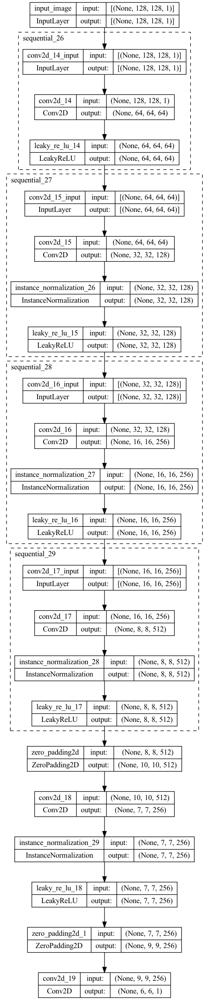

In [23]:
# Visualize model architecture of discriminator
plot_model(discriminator_x, show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True, dpi=96)

In [24]:
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 1)]     0         
                                                                 
 sequential_26 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_27 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 sequential_28 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 sequential_29 (Sequential)  (None, 8, 8, 512)         2098176   
                                                                 
 zero_padding2d (ZeroPadding  (None, 10, 10, 512)      0         
 2D)                                                             
                                                           


#### Sample Output of Untrained Generator


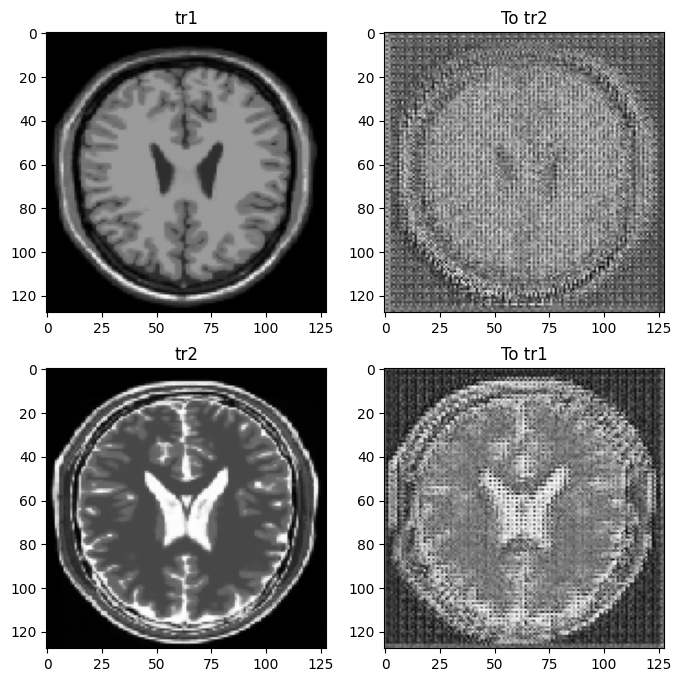

In [25]:
to_tr2 = generator_g(sample_tr1)
to_tr1 = generator_f(sample_tr2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_tr1, to_tr2, sample_tr2, to_tr1]
title = ['tr1', 'To tr2', 'tr2', 'To tr1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()


#### Binary Cross Entropy Loss

- Since our generator is a classifier, we choose Binary Cross Entropy Loss.


In [26]:
# Using Binarycross entropy with logits true
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss 

Two types of losses 

- Loss on Real Data 
- Loss on Fake Data 

In [27]:
# calculating discriminator loss by summing the real and generated
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses


#### Generator Loss 

- It has only one type of loss - Discriminator Loss on Generated data


In [28]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)


#### Cycle Loss 

- When two generators are sequentially used on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.


In [29]:
LAMBDA = 10 # Lambda is a weight used as contribution of corresponding loss to total loss. This is a hyperparameter.

In [30]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image)) #write your code here
    return LAMBDA * loss1


#### Identity Loss 

- When an input image is provided to the Generator such that, no translation required, as the image is already transformed, the should be a minimal difference between original and generated image. Here we also take L1 Loss between input and output image.


In [31]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image)) # Averages out all values in the input
    return LAMBDA * 0.5 * loss


#### Optimizer


In [32]:
# Optimizer with learning rate 2e-4 for generator and discriminator
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)


#### Checkpoint Initialization

- Initializing checkpoints to save models

In [33]:
EPOCHS = 100 #Here we use 100 Epochs to train our model

In [34]:
# Directory to keep Checkpoints at each epoch

checkpoint_path = './checkpoints'  
ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Restored Latest Checkpoint!')

In [35]:
# Directory to keep Generated Images each epoch
if not os.path.isdir('generated_images'):
    os.mkdir('generated_images')

# Function to show Images output by Generators while Training
def generate_images(model1, test_input1, model2, test_input2, epoch):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(9, 9))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input T1', 'T2 Prediction at Epoch ' + str(epoch), 'Input T2', 'T1 Prediction at Epoch ' + str(epoch)]
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('./generated_images/image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Model Training

- X corresponds to T1 Style Image
- Y corresponds to T2 Style Image

The one flow of batch training involves
 
- Generate Fake Y and Cycled X
- Generate Fake X and Cycled Y
- Generate Fake Images through X and Y for Identity Loss.
- Calculate Discriminator Loss for Disc X and Disc Y on Fake Data for Generator Training.
- Calculate Generator Loss on Discriminator.
- Calculate Cycled Loss on Cycled Images from step 1 and 2.
- Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
- Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
- Calculate the Gradients and update the weight and bias of models.

In [36]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X.
        fake_y = generator_g(real_x, training=True)  #write your code to generate images using Generator_g on real_x
        cycled_x = generator_f(fake_y, training=True) #write your code to generate images susiing Generator_f on fake_y
        
        fake_x =  generator_f(real_y, training=True) #write your code to generate images using Generator_f on real_y
        cycled_y = generator_g(fake_x, training=True) #write your code to generate images using Generator_g on fake_x
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True) #write your code to generate images using Generator_f on real_x
        same_y = generator_g(real_y, training=True) #write your code to generate images using Generator_g on real_y
        
        disc_real_x =  discriminator_x(real_x, training=True) #write your code to discriminate images using Discriminator_x on real_x
        disc_real_y = discriminator_y(real_y, training=True) #write your code to discriminate images using Discriminator_y on real_y
        
        disc_fake_x = discriminator_x(fake_x, training=True) #write your code to discriminate images using Discriminator_x on fake_x
        disc_fake_y = discriminator_y(fake_y, training=True) #write your code to discriminate images using Discriminator_y on fake_y
        
        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y) # calculate the generator_loss for disc_fake_
        gen_f_loss = generator_loss(disc_fake_x) # calculate the generator_loss for disc_fake_X 
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        #calculate the total cycle loss
        
        # Total generator loss = adversarial loss + cycle loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x) # calculate the discriminator_loss for disc_fake_x wrt disc_real_x
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y) # calculate the discriminator_loss foor disc_fake_y wrt disc_real_y
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss,generator_g.trainable_variables) #write your code here
    generator_f_gradients = tape.gradient(total_gen_f_loss,generator_f.trainable_variables) #write your code here
    
    discriminator_x_gradients = tape.gradient(disc_x_loss,discriminator_x.trainable_variables)#write your code here
    discriminator_y_gradients = tape.gradient(disc_y_loss,discriminator_y.trainable_variables)#write your code here
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients,generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients,generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,discriminator_y.trainable_variables)) #write your code here


#### CycleGAN Model Training for mentioned Epochs 

- Loop training function for number of epochs and display the output at each step.

2023-03-29 01:44:03.191550: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-03-29 01:44:27.339849: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


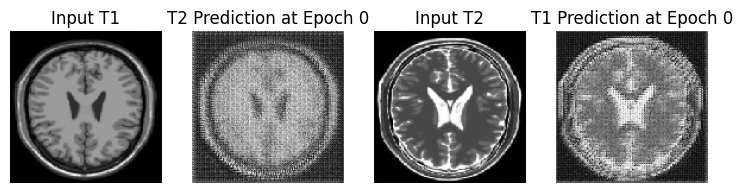

Saving checkpoint for epoch 0 at ./checkpoints/ckpt-1


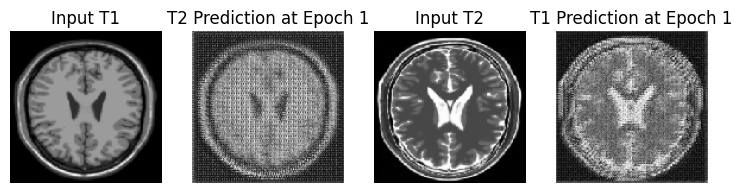

Saving checkpoint for epoch 1 at ./checkpoints/ckpt-2


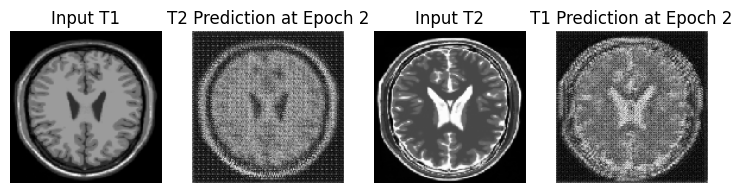

Saving checkpoint for epoch 2 at ./checkpoints/ckpt-3


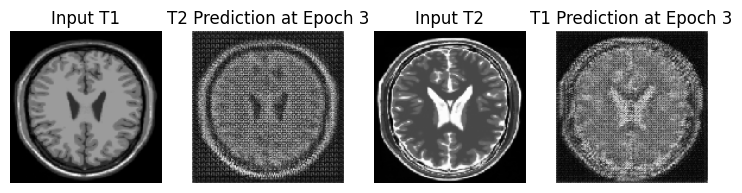

Saving checkpoint for epoch 3 at ./checkpoints/ckpt-4


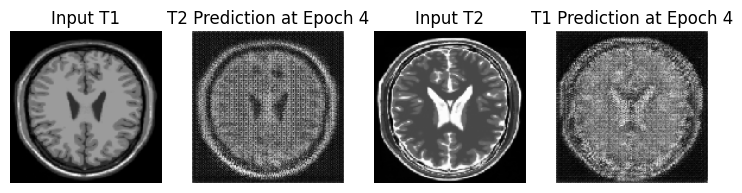

Saving checkpoint for epoch 4 at ./checkpoints/ckpt-5


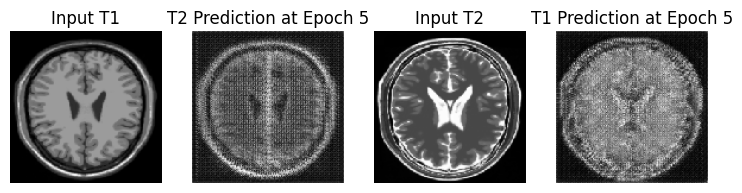

Saving checkpoint for epoch 5 at ./checkpoints/ckpt-6


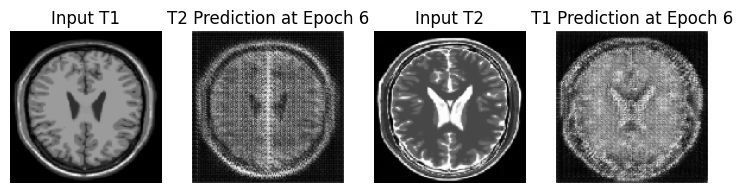

Saving checkpoint for epoch 6 at ./checkpoints/ckpt-7


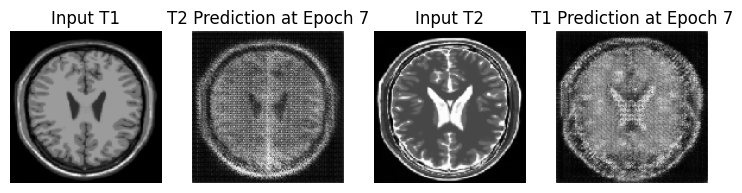

Saving checkpoint for epoch 7 at ./checkpoints/ckpt-8


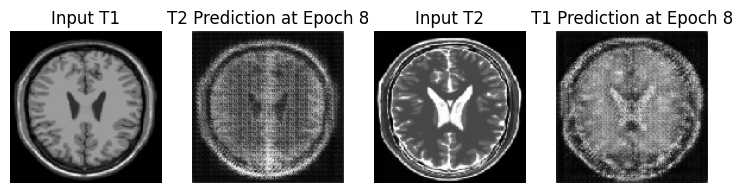

Saving checkpoint for epoch 8 at ./checkpoints/ckpt-9


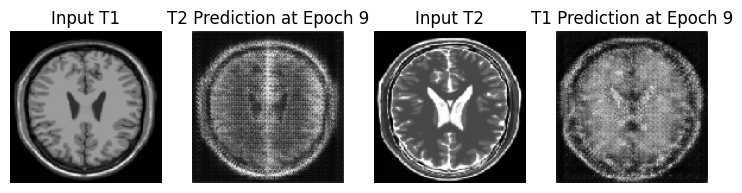

Saving checkpoint for epoch 9 at ./checkpoints/ckpt-10


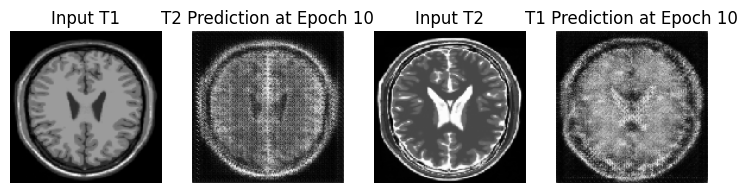

Saving checkpoint for epoch 10 at ./checkpoints/ckpt-11


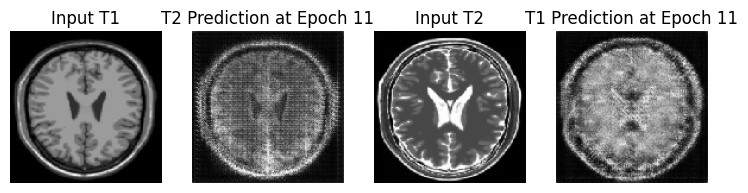

Saving checkpoint for epoch 11 at ./checkpoints/ckpt-12


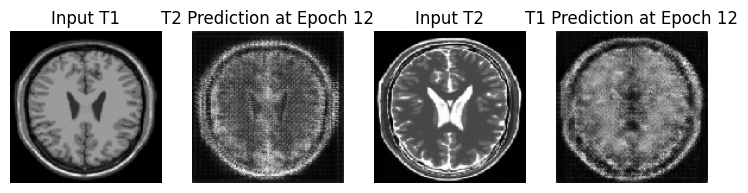

Saving checkpoint for epoch 12 at ./checkpoints/ckpt-13


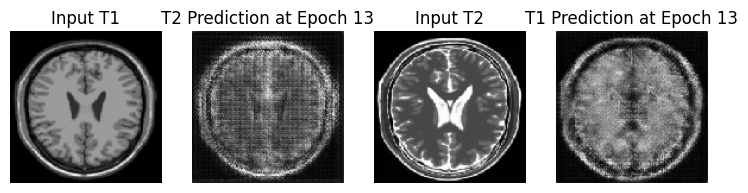

Saving checkpoint for epoch 13 at ./checkpoints/ckpt-14


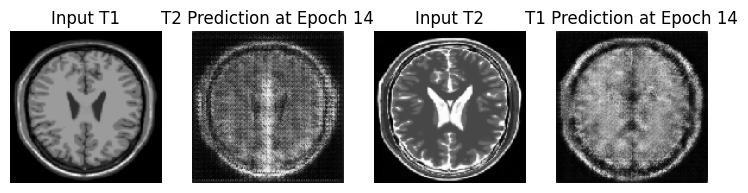

Saving checkpoint for epoch 14 at ./checkpoints/ckpt-15


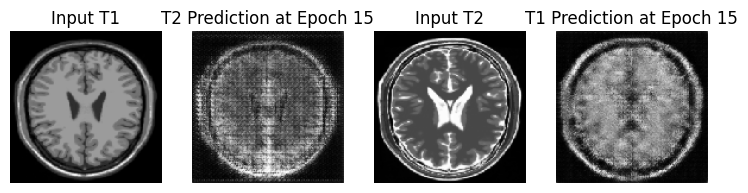

Saving checkpoint for epoch 15 at ./checkpoints/ckpt-16


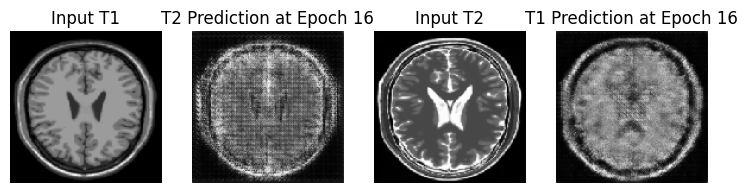

Saving checkpoint for epoch 16 at ./checkpoints/ckpt-17


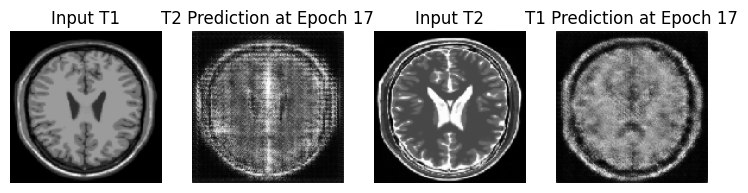

Saving checkpoint for epoch 17 at ./checkpoints/ckpt-18


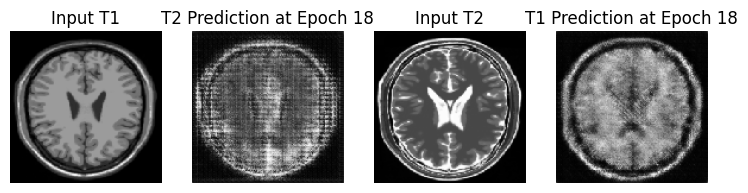

Saving checkpoint for epoch 18 at ./checkpoints/ckpt-19


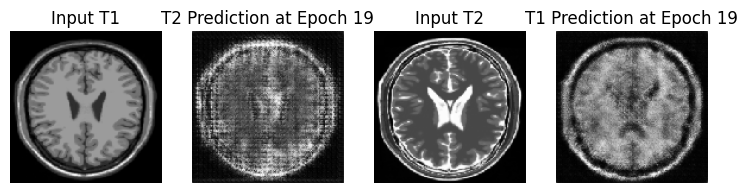

Saving checkpoint for epoch 19 at ./checkpoints/ckpt-20


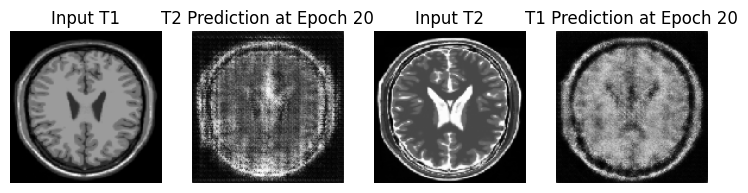

Saving checkpoint for epoch 20 at ./checkpoints/ckpt-21


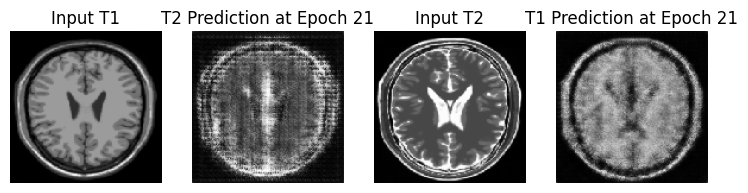

Saving checkpoint for epoch 21 at ./checkpoints/ckpt-22


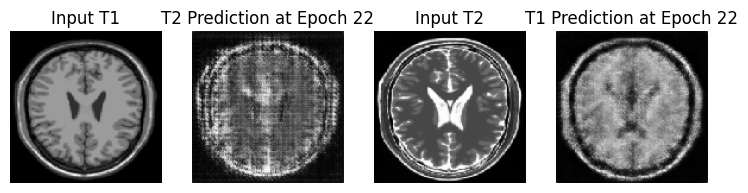

Saving checkpoint for epoch 22 at ./checkpoints/ckpt-23


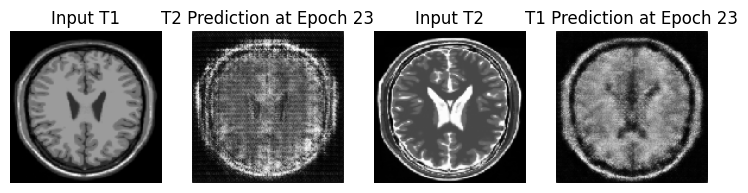

Saving checkpoint for epoch 23 at ./checkpoints/ckpt-24


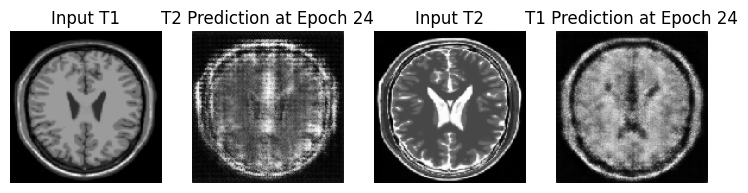

Saving checkpoint for epoch 24 at ./checkpoints/ckpt-25


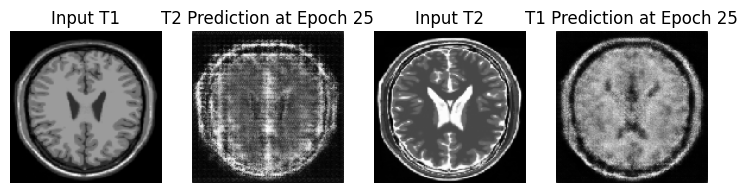

Saving checkpoint for epoch 25 at ./checkpoints/ckpt-26


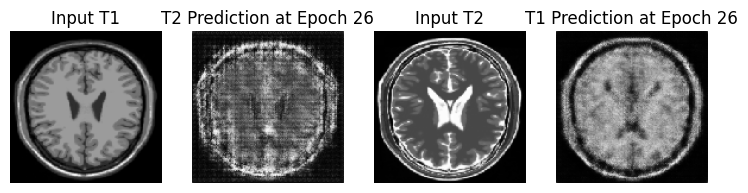

Saving checkpoint for epoch 26 at ./checkpoints/ckpt-27


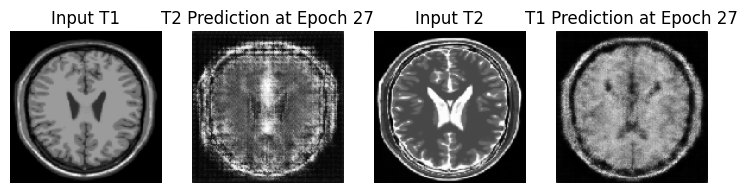

Saving checkpoint for epoch 27 at ./checkpoints/ckpt-28


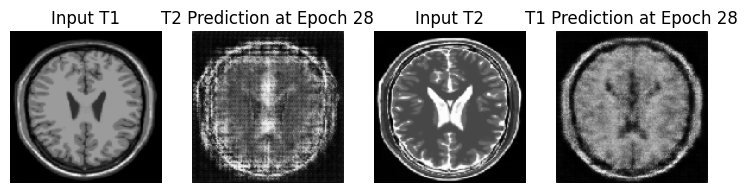

Saving checkpoint for epoch 28 at ./checkpoints/ckpt-29


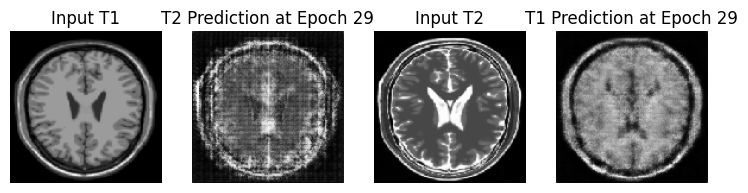

Saving checkpoint for epoch 29 at ./checkpoints/ckpt-30


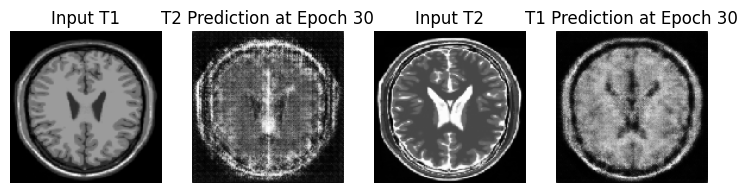

Saving checkpoint for epoch 30 at ./checkpoints/ckpt-31


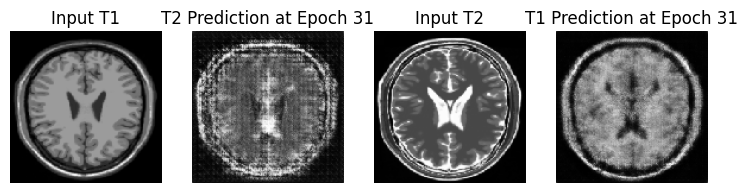

Saving checkpoint for epoch 31 at ./checkpoints/ckpt-32


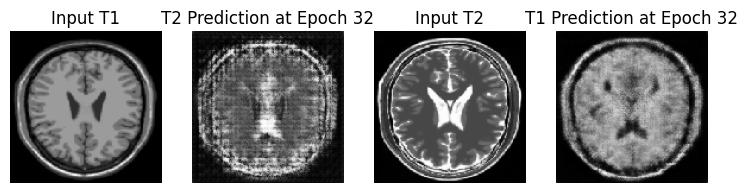

Saving checkpoint for epoch 32 at ./checkpoints/ckpt-33


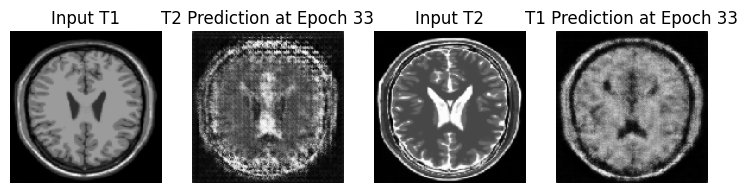

Saving checkpoint for epoch 33 at ./checkpoints/ckpt-34


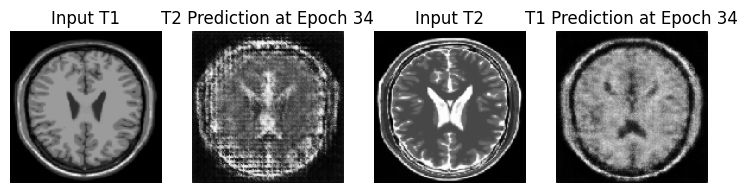

Saving checkpoint for epoch 34 at ./checkpoints/ckpt-35


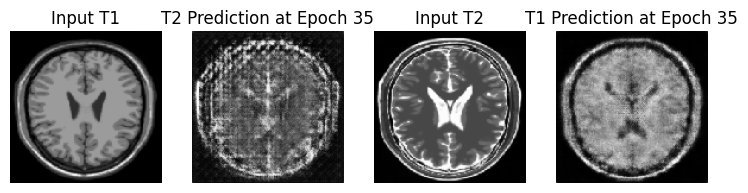

Saving checkpoint for epoch 35 at ./checkpoints/ckpt-36


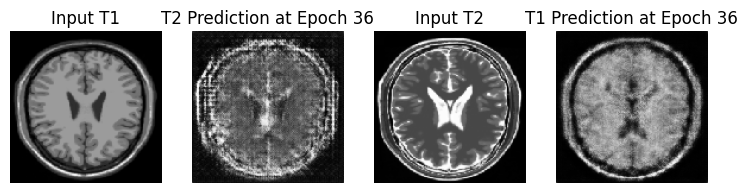

Saving checkpoint for epoch 36 at ./checkpoints/ckpt-37


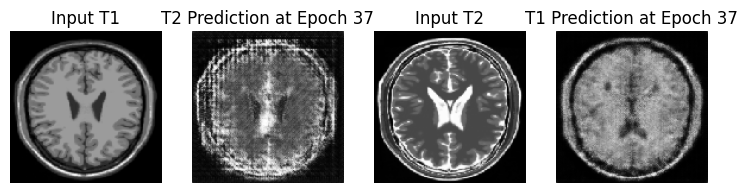

Saving checkpoint for epoch 37 at ./checkpoints/ckpt-38


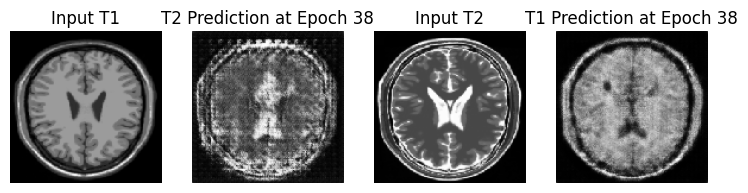

Saving checkpoint for epoch 38 at ./checkpoints/ckpt-39


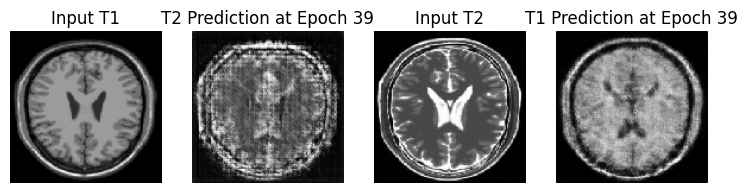

Saving checkpoint for epoch 39 at ./checkpoints/ckpt-40


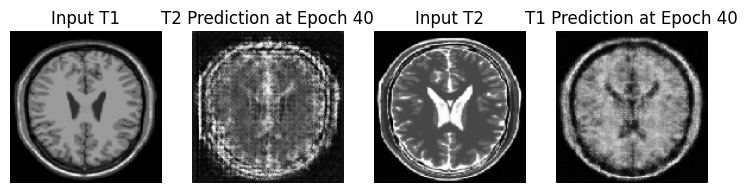

Saving checkpoint for epoch 40 at ./checkpoints/ckpt-41


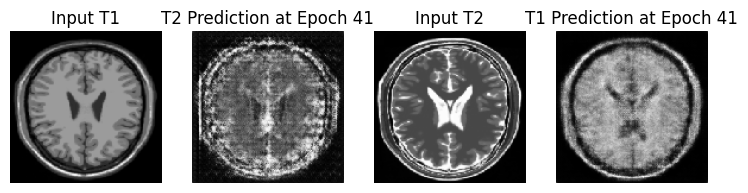

Saving checkpoint for epoch 41 at ./checkpoints/ckpt-42


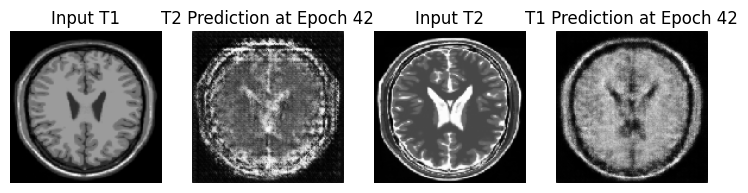

Saving checkpoint for epoch 42 at ./checkpoints/ckpt-43


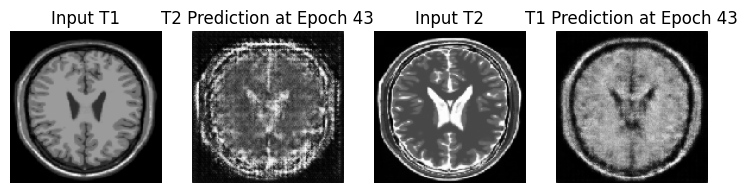

Saving checkpoint for epoch 43 at ./checkpoints/ckpt-44


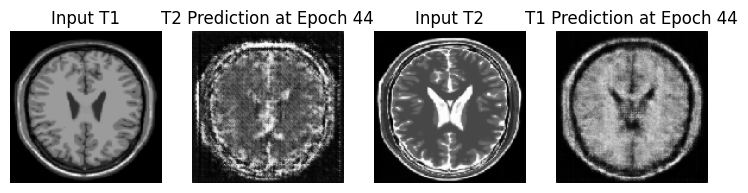

Saving checkpoint for epoch 44 at ./checkpoints/ckpt-45


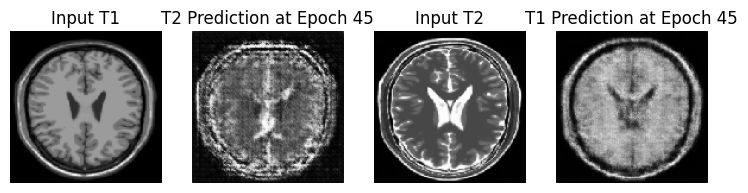

Saving checkpoint for epoch 45 at ./checkpoints/ckpt-46


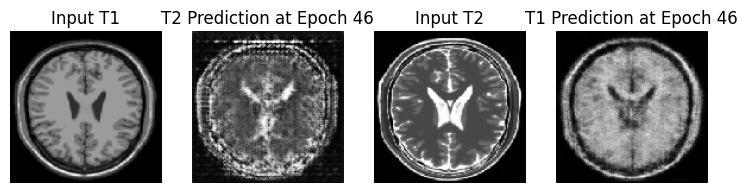

Saving checkpoint for epoch 46 at ./checkpoints/ckpt-47


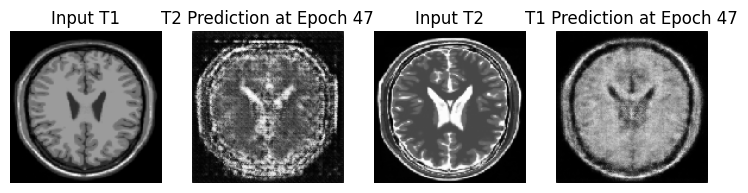

Saving checkpoint for epoch 47 at ./checkpoints/ckpt-48


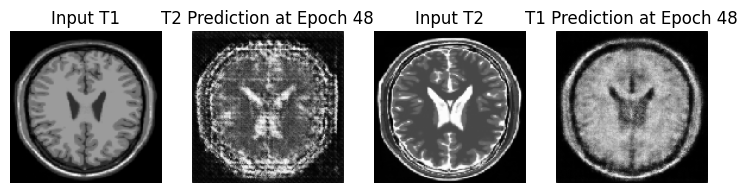

Saving checkpoint for epoch 48 at ./checkpoints/ckpt-49


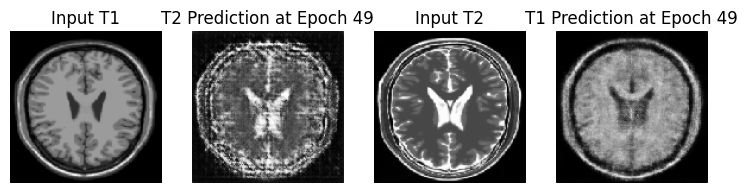

Saving checkpoint for epoch 49 at ./checkpoints/ckpt-50


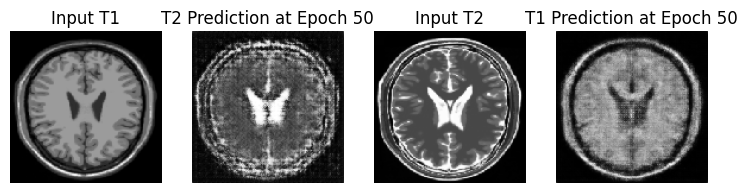

Saving checkpoint for epoch 50 at ./checkpoints/ckpt-51


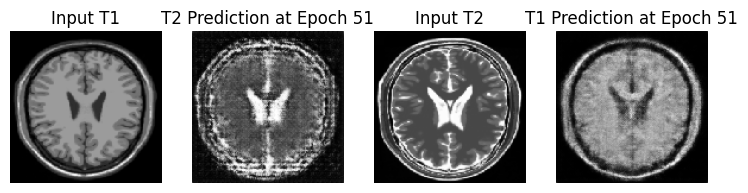

Saving checkpoint for epoch 51 at ./checkpoints/ckpt-52


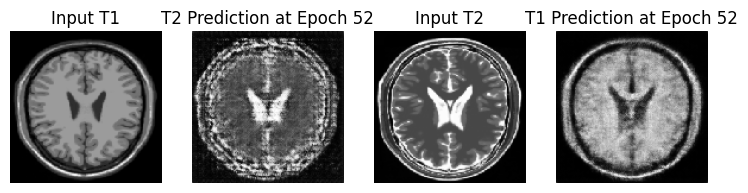

Saving checkpoint for epoch 52 at ./checkpoints/ckpt-53


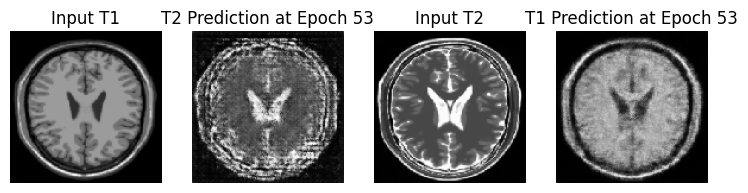

Saving checkpoint for epoch 53 at ./checkpoints/ckpt-54


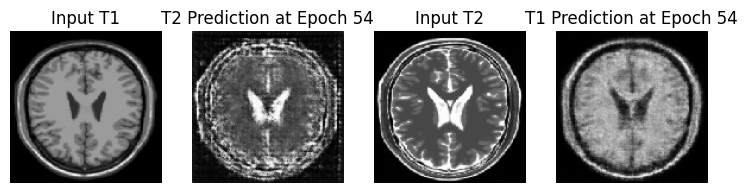

Saving checkpoint for epoch 54 at ./checkpoints/ckpt-55


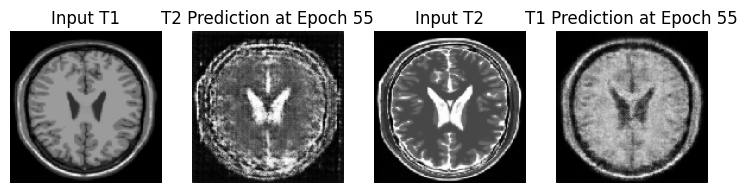

Saving checkpoint for epoch 55 at ./checkpoints/ckpt-56


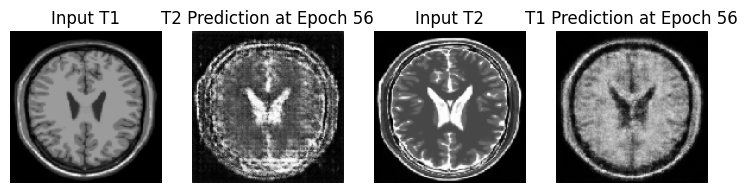

Saving checkpoint for epoch 56 at ./checkpoints/ckpt-57


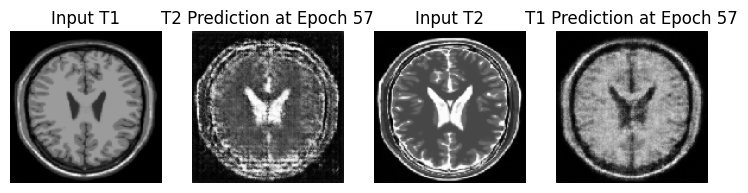

Saving checkpoint for epoch 57 at ./checkpoints/ckpt-58


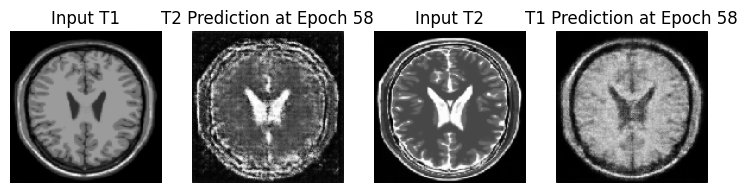

Saving checkpoint for epoch 58 at ./checkpoints/ckpt-59


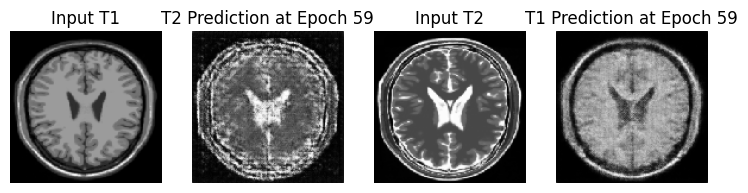

Saving checkpoint for epoch 59 at ./checkpoints/ckpt-60


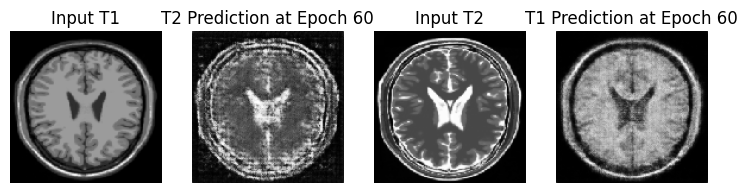

Saving checkpoint for epoch 60 at ./checkpoints/ckpt-61


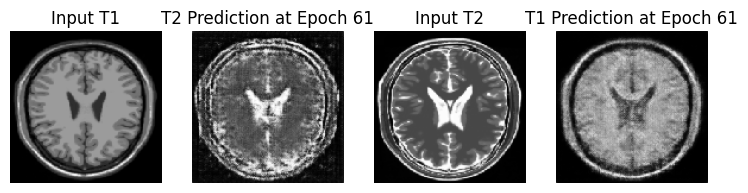

Saving checkpoint for epoch 61 at ./checkpoints/ckpt-62


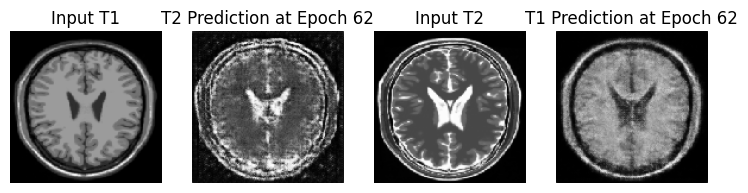

Saving checkpoint for epoch 62 at ./checkpoints/ckpt-63


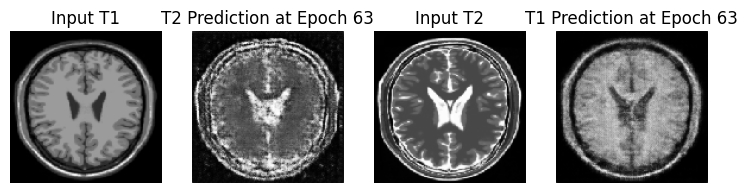

Saving checkpoint for epoch 63 at ./checkpoints/ckpt-64


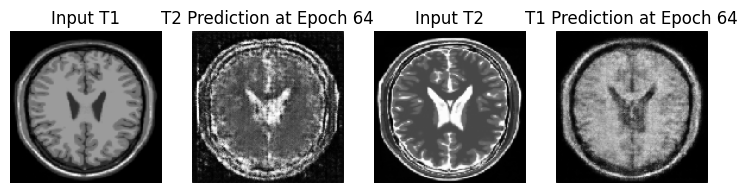

Saving checkpoint for epoch 64 at ./checkpoints/ckpt-65


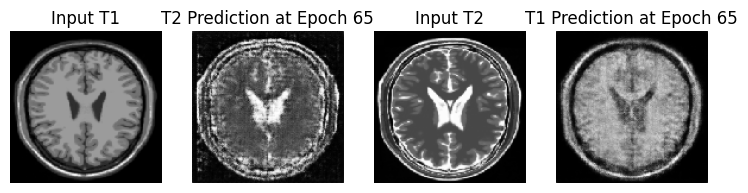

Saving checkpoint for epoch 65 at ./checkpoints/ckpt-66


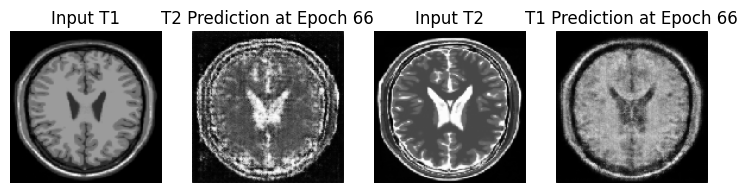

Saving checkpoint for epoch 66 at ./checkpoints/ckpt-67


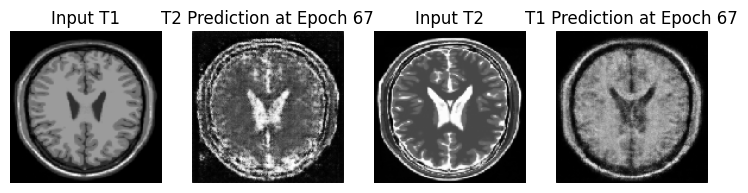

Saving checkpoint for epoch 67 at ./checkpoints/ckpt-68


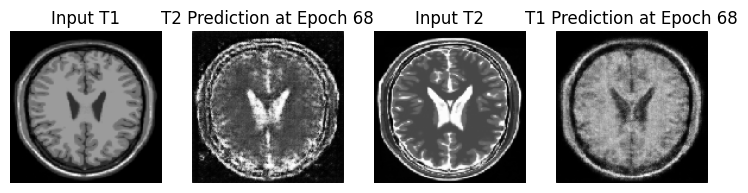

Saving checkpoint for epoch 68 at ./checkpoints/ckpt-69


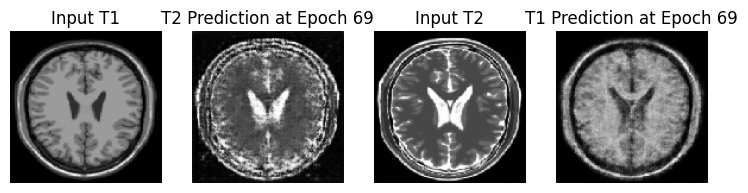

Saving checkpoint for epoch 69 at ./checkpoints/ckpt-70


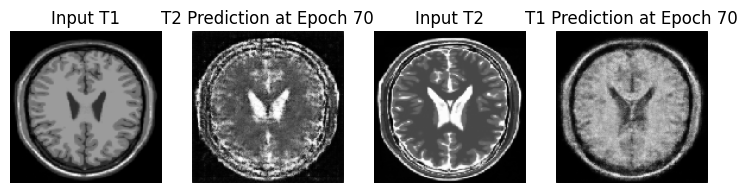

Saving checkpoint for epoch 70 at ./checkpoints/ckpt-71


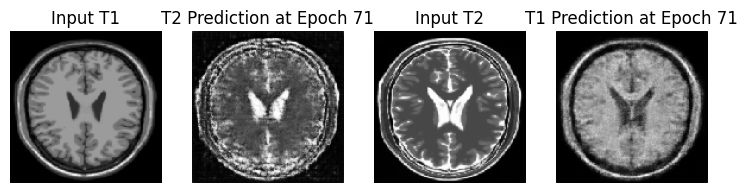

Saving checkpoint for epoch 71 at ./checkpoints/ckpt-72


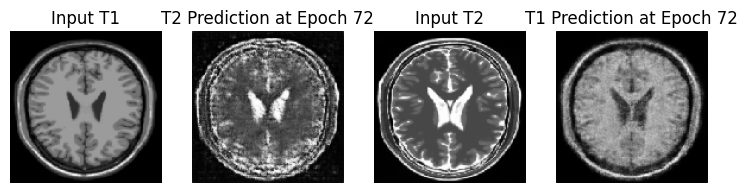

Saving checkpoint for epoch 72 at ./checkpoints/ckpt-73


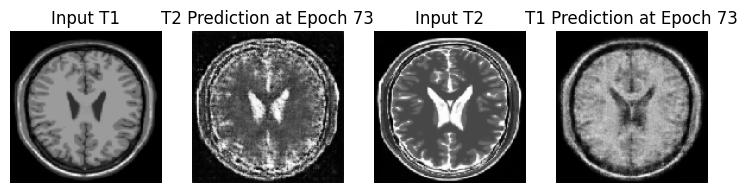

Saving checkpoint for epoch 73 at ./checkpoints/ckpt-74


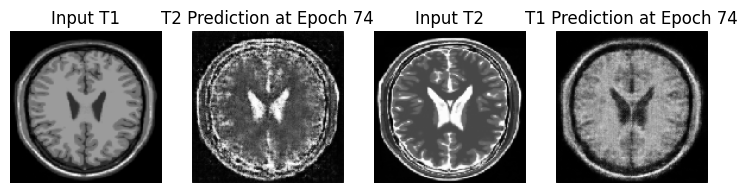

Saving checkpoint for epoch 74 at ./checkpoints/ckpt-75


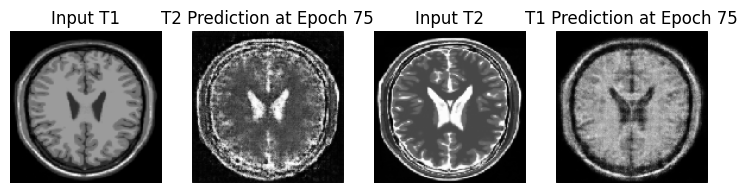

Saving checkpoint for epoch 75 at ./checkpoints/ckpt-76


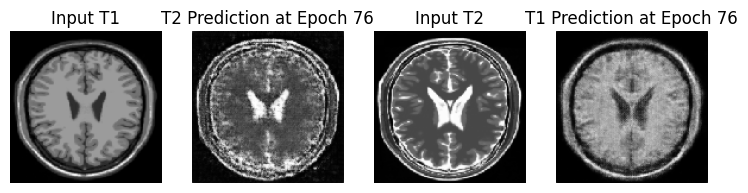

Saving checkpoint for epoch 76 at ./checkpoints/ckpt-77


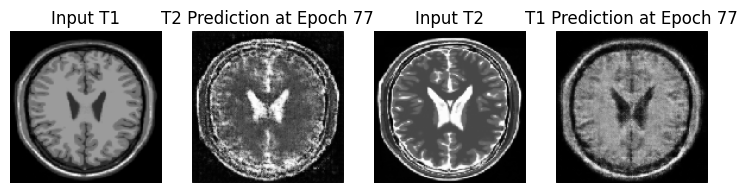

Saving checkpoint for epoch 77 at ./checkpoints/ckpt-78


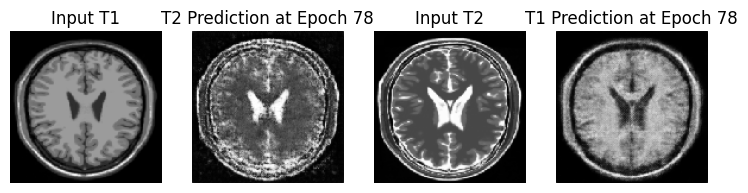

Saving checkpoint for epoch 78 at ./checkpoints/ckpt-79


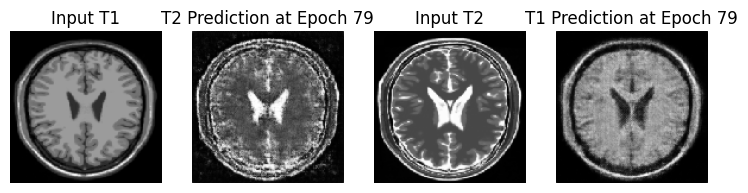

Saving checkpoint for epoch 79 at ./checkpoints/ckpt-80


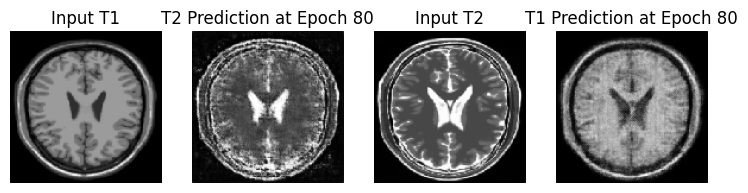

Saving checkpoint for epoch 80 at ./checkpoints/ckpt-81


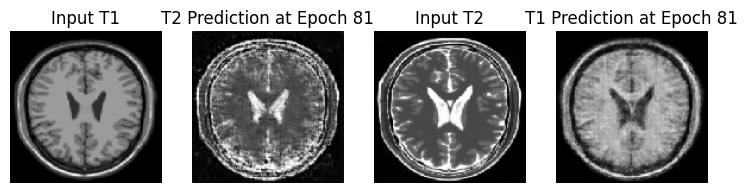

Saving checkpoint for epoch 81 at ./checkpoints/ckpt-82


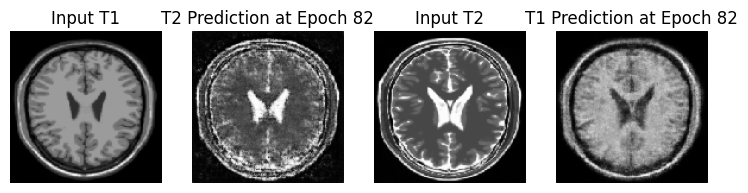

Saving checkpoint for epoch 82 at ./checkpoints/ckpt-83


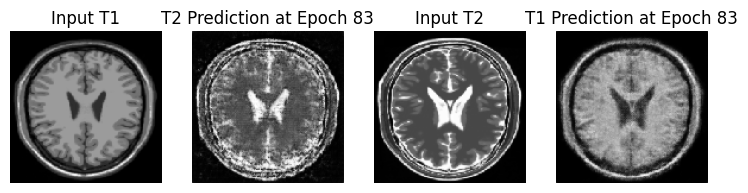

Saving checkpoint for epoch 83 at ./checkpoints/ckpt-84


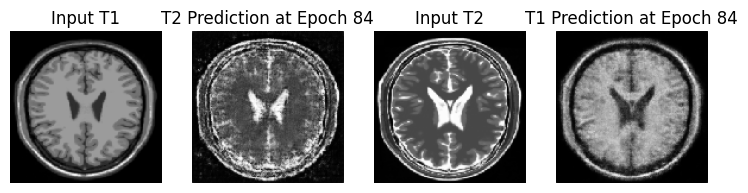

Saving checkpoint for epoch 84 at ./checkpoints/ckpt-85


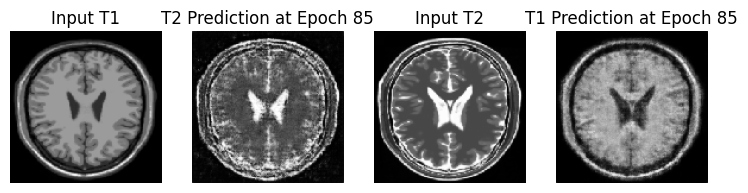

Saving checkpoint for epoch 85 at ./checkpoints/ckpt-86


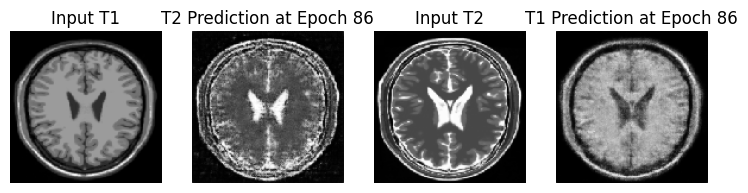

Saving checkpoint for epoch 86 at ./checkpoints/ckpt-87


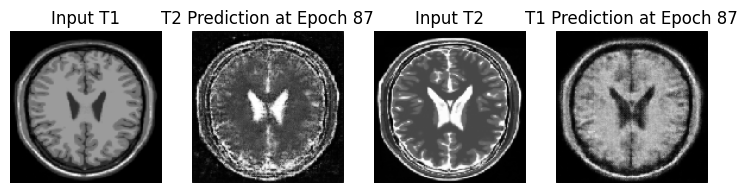

Saving checkpoint for epoch 87 at ./checkpoints/ckpt-88


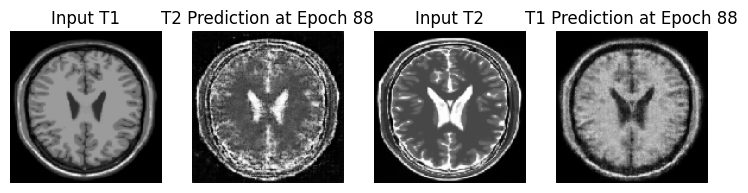

Saving checkpoint for epoch 88 at ./checkpoints/ckpt-89


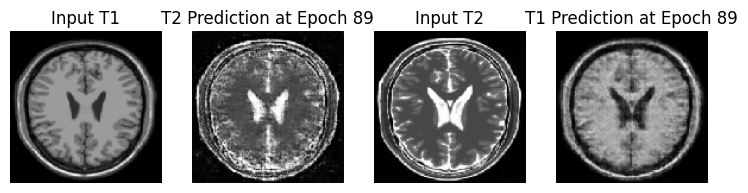

Saving checkpoint for epoch 89 at ./checkpoints/ckpt-90


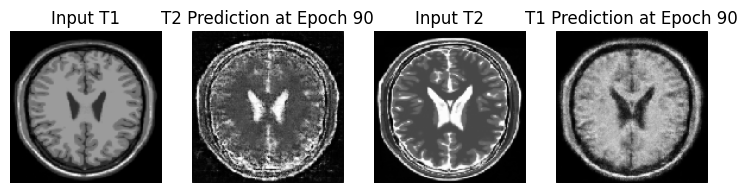

Saving checkpoint for epoch 90 at ./checkpoints/ckpt-91


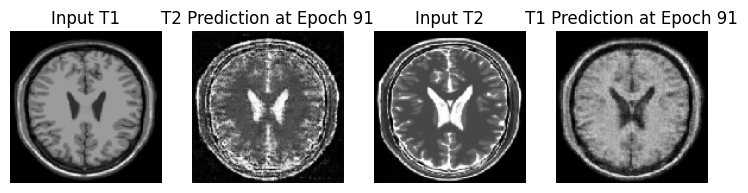

Saving checkpoint for epoch 91 at ./checkpoints/ckpt-92


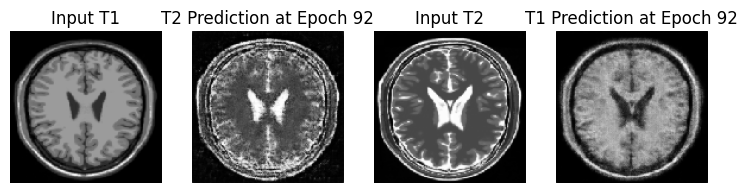

Saving checkpoint for epoch 92 at ./checkpoints/ckpt-93


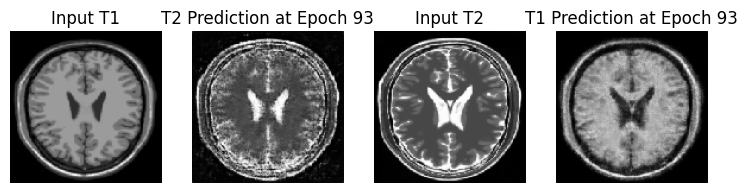

Saving checkpoint for epoch 93 at ./checkpoints/ckpt-94


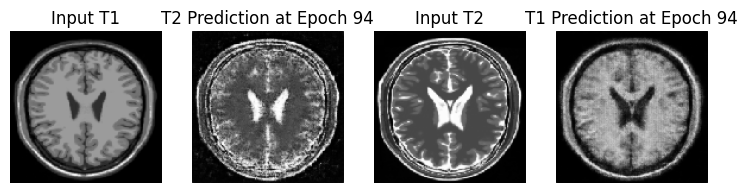

Saving checkpoint for epoch 94 at ./checkpoints/ckpt-95


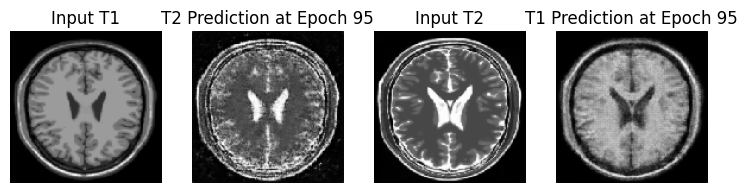

Saving checkpoint for epoch 95 at ./checkpoints/ckpt-96


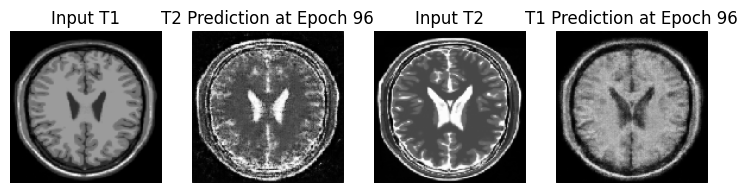

Saving checkpoint for epoch 96 at ./checkpoints/ckpt-97


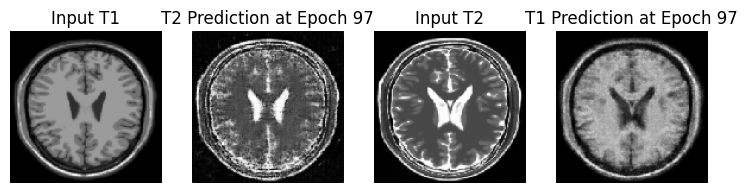

Saving checkpoint for epoch 97 at ./checkpoints/ckpt-98


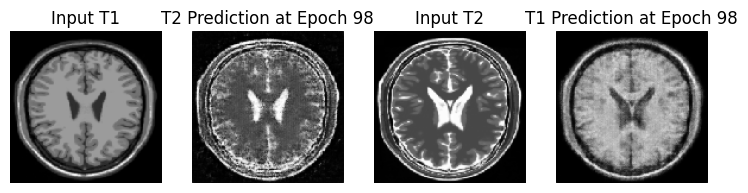

Saving checkpoint for epoch 98 at ./checkpoints/ckpt-99


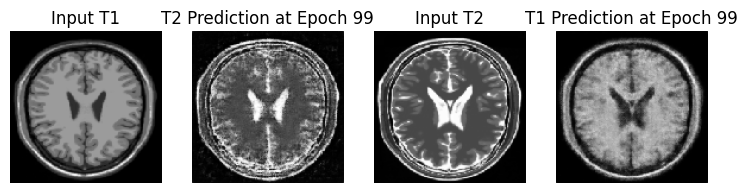

Saving checkpoint for epoch 99 at ./checkpoints/ckpt-100


In [37]:
#Model Training
for epoch in range(EPOCHS): #epoch starts from 0 and ends at 99
    for image_x, image_y in tf.data.Dataset.zip((tr1, tr2)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_tr1, generator_f, sample_tr2, epoch) 
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

#### Generating Results using GIF file for visualization


In [38]:
gif_file = 'MRI_Style_Transfer_T1_T2.gif'

with imageio.get_writer(gif_file, mode='I') as writer:
  filenames = glob.glob('./generated_images/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


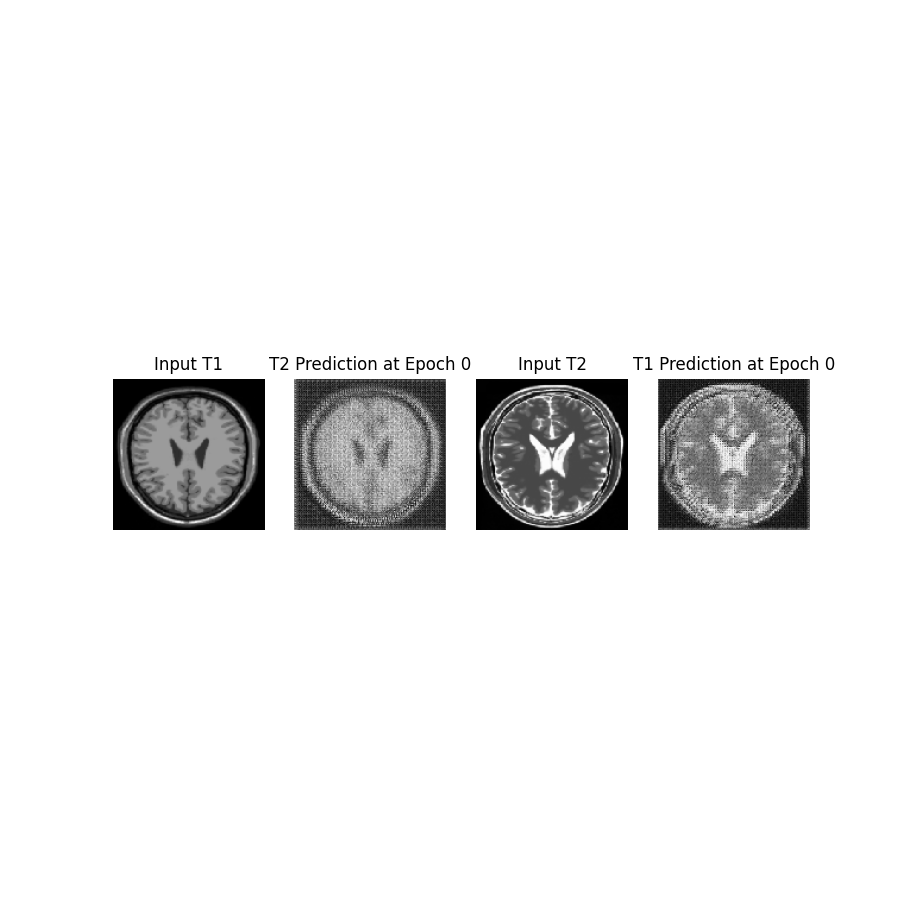

In [39]:
#Visualising results for each epoch using GIF
import tensorflow_docs.vis.embed as embed
embed.embed_file(gif_file)

## Conclusion 

- The translation of the style of T1 weighted MRI images to T2 weighted MRI image inputs, and vice versa is effectively achieved using A `Cycle GAN` architecture.

In [40]:
!rm -rf checkpoints